Re-do ICA finalized code on my Github.  These *should* produce more accurate reconstructions, especially with spectra which have a lot of their wavelength coverage masked, but we'll see.  Either way, should declare victory after these.

In [1]:
import glob
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
import matplotlib
#import richardsplot as rplot
import os
from astropy.io import fits
from astropy.table import Table
import pandas as pd
import sys
sys.path.append(os.path.abspath(os.path.join('.'))+"\\components")
sys.path.append(os.path.abspath(os.path.join('.'))+"\\ICA Scripts")
#sys.path.append("/Volumes/Macintosh HD 1/Users/trevormccaffrey/Desktop/HST/AllHSTCode/")
#sys.path.append("/Users/trevormccaffrey/Dropbox/HST/HSTCode/")
#sys.path.append("/Users/trevormccaffrey/Dropbox/HST/HSTCode/")
from Small_Pix_Filter_TVM import SDSS_pixel_filter
import MorphingEdges_FOS
import MorphingEdges_STIS
import MorphingEdges_COS
import MorphingEdges_HSLA
import MorphingEdges
import CIV_BAL_regions
#Use the package that Amy used for determining weights
from lmfit import minimize, Parameters

#sys.path.append("/Users/trevormccaffrey/Dropbox/ICA_module/code_main/")
#sys.path.append("/Users/Trevor1/Dropbox/ICA_module/")
import run_ICA_r20_components
import spec_morph

%load_ext autoreload
%autoreload 2

In [4]:
plt.rcParams["xtick.top"] = True
plt.rcParams["ytick.right"] = True

---

In [11]:
ica_path = "/Users/trevormccaffrey/Dropbox/HST/ICA/"

In [2]:
%%capture

def blueshift(wave_half_flux):
    return ((1549.48 - wave_half_flux) / 1549.48) * 3e5

def get_CIV(wave, flux, wave_r, flux_r, name, ax=plt.gca(), EW_region=[1500,1600], cont_region=[[1445,1465],[1700,1705]], good=1):
    #print("Getting CIV")
    #Going to save plots, but not show with magic above
    #"""
    ylow, yup = max(0, np.percentile(flux_r, 1)-np.nanmedian(flux_r)/5), np.percentile(flux_r, 99)+np.nanpercentile(flux_r, 95)
    #fig, ax = plt.subplots(figsize=(9,9))
    #fig = plt.figure(figsize=(9,9))
    ax.plot(wave, flux, "-k", alpha=0.5)#, label="HST co-add")
    ax.plot(wave_r, flux_r, "-r", lw=1.8)#, label="ICA fit")
    ax.plot([1549.48,1549.48], [ylow,yup], "--k", label="CIV Rest")
    #"""
    
    #Fit continuum -- ADD MANUAL HERE
    cont1 = ((wave_r>=cont_region[0][0])&(wave_r<=cont_region[0][1]))
    cont2 = ((wave_r>=cont_region[1][0])&(wave_r<=cont_region[1][1]))
    ax.axvspan(cont_region[0][0], cont_region[0][1], alpha=0.5, color='grey')
    ax.axvspan(cont_region[1][0], cont_region[1][1], alpha=0.5, color='grey')

    m,b = np.polyfit(np.concatenate((wave_r[cont1], wave_r[cont2])), np.concatenate((flux_r[cont1], flux_r[cont2])), 1)
    continuum = wave_r*m + b
    ax.plot(wave_r, continuum, "-m")
    
    #Plot EW region under flux_r -- ADD MANUAL HERE
    EW = ((wave_r>=EW_region[0])&(wave_r<=EW_region[1]))

    #And compute the EW
    CIV_EW = 0
    ew_list = [0.]
    for i in range(len(wave_r[EW])):
        try:
            CIV_EW += max(( (flux_r[EW][i] - continuum[i]) / continuum[i] ) * ( wave_r[EW][i+1] - wave_r[EW][i] ), 0) #no absorption
        except IndexError:
            CIV_EW += max(( (flux_r[EW][i] - continuum[i]) / continuum[i] ) * ( wave_r[EW][i] - wave_r[EW][i-1] ), 0)

        ew_list.append(CIV_EW)

    ax.fill_between(wave_r[EW], continuum[EW], flux_r[EW], color="blue", alpha=0.2, label="%.1f Å"%CIV_EW)

    ind_half_flux = abs((CIV_EW / 2) - np.array(ew_list)).argmin()
    CIV_blue = blueshift(wave_r[EW][ind_half_flux])
    #"""  
    #for w in np.arange(1450,1530,10): ax.plot([w,w],[ylow,yup],"--",label=str(w))
    #for w in np.arange(1610,1640,10): ax.plot([w,w],[ylow,yup],"--",label=str(w))
    ax.plot([EW_region[0],EW_region[0]], [ylow,yup], "-b", alpha=0.7)
    ax.plot([EW_region[1],EW_region[1]], [ylow,yup], "-b", alpha=0.7)
    ax.plot([wave_r[EW][ind_half_flux],wave_r[EW][ind_half_flux]], [ylow,yup], "--b", label="%.1f km/s" % (CIV_blue))
    ax.set_xlim(1435, 1710)
    ax.set_ylim(ylow, yup)
    ax.set_xlabel("Wavelength (Å)", fontsize=20)
    #ax.set_ylabel("Flux (Arbitrary Units)", fontsize=20)
    #ax.set_title("Blue, EW = %.2f km/s, %.2f Å" % (CIV_blue,CIV_EW), fontsize=20)
    ax.set_title(name, fontsize=20)
    ax.tick_params(axis='both', which='major', labelsize=17.5)
    ax.tick_params(axis='both', which='minor', labelsize=17.5)
    ax.tick_params(labelleft=False)
    ax.legend(loc="best", prop={"size":12.5})
    #plt.tight_layout()
    """
    if good == 1:
        plt.savefig("/Users/Trevor1/Dropbox/HST/CIV_fits_final/good/%s.png"%name)
    else:
        plt.savefig("/Users/Trevor1/Dropbox/HST/CIV_fits_final/bad/%s.png"%name)
    #plt.show()
    """    
    return CIV_blue, CIV_EW

In [3]:
#!ls /Users/trevormccaffrey/Dropbox/HST/final_tables

In [6]:
#dat = pd.read_csv("/Users/trevormccaffrey/Dropbox/HST/final_tables/HST_CIV_Sulentic2007_HSLA2018_finalprops.csv")
dat = pd.read_csv("HST_CIV_Sulentic2007_HSLA2018_finalprops.csv")
dat.head()

,Final_Name,Alt_Name,Inst_final,z,z_src,CIV_blue_tvm,CIV_EW_tvm,_RA,_DE,Sul_Name,...,logLEdd,logLEdd_Source,logLEdd_Source_qual,F2500 (ergs/s/cm2/A),F2500_change,logLbol_2500 (erg/s),logLedd (erg/s),logEddRatio_2500,CIV_Distance,Spec_Name
0,1H 0707-495,2MASS J07084147-4933063,STIS,0.04080,Sul,1437.482252,6.095122,107.173050,-49.551842,J07086-4933,...,NaN,NaN,NaN,6.785221e-15,6.785221e-15,44.295900,44.400371,-0.104471,0.896653,J07086-4933
1,1H 1613-097,2MASS J16151905-0936132,HSLA,0.06496,https://arxiv.org/pdf/2108.11958.pdf,59.381212,68.570031,243.829000,-9.603690,NaN,...,NaN,NaN,NaN,2.591391e-15,2.591391e-15,44.296881,45.040371,-0.743489,0.395527,1H1613-097
2,2E 1013,PKS 0420-01,FOS,0.91500,Sul,-78.781269,58.892013,65.815836,-1.342518,J04232-0120,...,NaN,NaN,NaN,2.515154e-16,2.515154e-16,45.877265,47.130371,-1.253106,0.432297,J04232-0120
3,2E 1135,PKS 0439-43,FOS,0.59380,Sul,335.512559,68.375473,70.322167,-43.229278,J04412-4313,...,NaN,NaN,NaN,1.229594e-15,1.229594e-15,46.103335,46.180371,-0.077036,0.396815,J04412-4313
4,2E 1644,IRAS L06229-6434,HSLA,0.12900,https://arxiv.org/pdf/1710.10703.pdf,-493.636575,80.774877,95.782000,-64.605800,NaN,...,NaN,NaN,NaN,5.858584e-15,5.858584e-15,45.271568,45.900371,-0.628803,0.352018,IRAS-L06229-6434


In [7]:
dat.columns

Index(['Final_Name', 'Alt_Name', 'Inst_final', 'z', 'z_src', 'CIV_blue_tvm',
       'CIV_EW_tvm', '_RA', '_DE', 'Sul_Name', 'SDSS_NAME', 'PLATE', 'MJD',
       'FIBERID', 'F1450_spec (erg/s/cm2/A)', 'S2N_1450A', 'CIVgood_manmask',
       'F1550_sul07', 'c1_2_sul07', 'log M_BH', '+err(log M_BH)',
       '-err(log M_BH)', 'MBH_source', 'MBH_source_qual', 'logEddRatio',
       'EddRatio_Source', 'EddRatio_Source_qual', 'LBol', 'LBol Source',
       'LBol_Source_qual', 'logLEdd', 'logLEdd_Source', 'logLEdd_Source_qual',
       'F2500 (ergs/s/cm2/A)', 'F2500_change', 'logLbol_2500 (erg/s)',
       'logLedd (erg/s)', 'logEddRatio_2500', 'CIV_Distance', 'Spec_Name'],
      dtype='object')

In [8]:
names = dat["Final_Name"].values
names_spec = dat["Spec_Name"].values #original names when spectra were created
inst_final = dat["Inst_final"].values
good = dat["CIVgood_manmask"].values

In [9]:
(names=="NGC5548").sum()

0

In [10]:
#! ls /Users/Trevor1/Dropbox/HST/RebinnedSpec_2022Aug11

In [11]:
dat

,Final_Name,Alt_Name,Inst_final,z,z_src,CIV_blue_tvm,CIV_EW_tvm,_RA,_DE,Sul_Name,...,logLEdd,logLEdd_Source,logLEdd_Source_qual,F2500 (ergs/s/cm2/A),F2500_change,logLbol_2500 (erg/s),logLedd (erg/s),logEddRatio_2500,CIV_Distance,Spec_Name
0,1H 0707-495,2MASS J07084147-4933063,STIS,0.04080,Sul,1437.482252,6.095122,107.173050,-49.551842,J07086-4933,...,NaN,NaN,NaN,6.785221e-15,6.785221e-15,44.295900,44.400371,-0.104471,0.896653,J07086-4933
1,1H 1613-097,2MASS J16151905-0936132,HSLA,0.06496,https://arxiv.org/pdf/2108.11958.pdf,59.381212,68.570031,243.829000,-9.603690,NaN,...,NaN,NaN,NaN,2.591391e-15,2.591391e-15,44.296881,45.040371,-0.743489,0.395527,1H1613-097
2,2E 1013,PKS 0420-01,FOS,0.91500,Sul,-78.781269,58.892013,65.815836,-1.342518,J04232-0120,...,NaN,NaN,NaN,2.515154e-16,2.515154e-16,45.877265,47.130371,-1.253106,0.432297,J04232-0120
3,2E 1135,PKS 0439-43,FOS,0.59380,Sul,335.512559,68.375473,70.322167,-43.229278,J04412-4313,...,NaN,NaN,NaN,1.229594e-15,1.229594e-15,46.103335,46.180371,-0.077036,0.396815,J04412-4313
4,2E 1644,IRAS L06229-6434,HSLA,0.12900,https://arxiv.org/pdf/1710.10703.pdf,-493.636575,80.774877,95.782000,-64.605800,NaN,...,NaN,NaN,NaN,5.858584e-15,5.858584e-15,45.271568,45.900371,-0.628803,0.352018,IRAS-L06229-6434
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
202,Ton S 180,PHL 912,STIS,0.06200,Sul,542.446498,18.535372,14.334174,-22.382344,J00573-2222,...,NaN,NaN,NaN,1.799458e-14,1.799458e-14,45.085694,45.160371,-0.074676,0.681286,TONS180
203,Ton S 210,1ESÂ 0119-28.6,HSLA,0.11600,https://arxiv.org/pdf/1507.06317.pdf,266.508764,26.374028,20.464600,-28.349400,NaN,...,NaN,NaN,NaN,1.520099e-14,1.520099e-14,45.581928,46.280371,-0.698443,0.590919,TONS210
204,UKS 0242-72.4,2MASS J02430960-7216482,HSLA,0.10200,NED,404.496993,34.428128,40.790000,-72.280100,NaN,...,NaN,NaN,NaN,4.496579e-15,4.496579e-15,44.941670,NaN,NaN,0.561679,UKS-0242-724
205,VIII Zw 233,SDSSÂ J130534.49+181932.9,HSLA,0.11800,DR16,-217.001833,32.895908,196.394000,18.325800,NaN,...,NaN,NaN,NaN,1.167308e-15,1.167308e-15,44.497620,46.480371,-1.982751,0.517155,NEWQZ004


In [12]:
def plot_HST(wave, flux, mask, ax):
    iplot_start = 0
    #iplot_end   = 0
    mask_curr   = mask[0]
    for i in range(len(wave)):
        #go until mask is a different value
        if mask[i]!=mask_curr or i==len(wave)-1:
            if mask_curr==3:
                #plot BAL region
                ax.plot(wave[iplot_start:i], flux[iplot_start:i], "-b", zorder=2, alpha=0.6)
            elif mask_curr==2:
                #plot NAL region
                ax.plot(wave[iplot_start:i], flux[iplot_start:i], "-y", zorder=2, alpha=0.6)
            elif mask_curr==1:
                #plot badpix region
                ax.plot(wave[iplot_start:i], flux[iplot_start:i], "-m", zorder=2, alpha=0.6)
            else:
                #plot BAL region
                ax.plot(wave[iplot_start:i], flux[iplot_start:i], "-k", zorder=1, alpha=0.7)

            mask_curr = mask[i]
            iplot_start = i
            
    ax.plot([1e7,1e7], [1e7,1e8], "-b", zorder=2, alpha=0.6, label="BAL Mask")
    ax.plot([1e7,1e7], [1e7,1e8], "-y", zorder=2, alpha=0.6, label="NAL Mask")
    ax.plot([1e7,1e7], [1e7,1e8], "-m", zorder=2, alpha=0.6, label="Input Bad Pixels")

In [13]:
names_save = []
for n in names:
    names_save.append("-".join(n.split(" ")))
names_save

['1H-0707-495',
 '1H-1613-097',
 '2E-1013',
 '2E-1135',
 '2E-1644',
 '2E-2889',
 '2E-3345',
 '2E-4226',
 '2E-935',
 '2MASS-J00481898+3941116',
 '2MASS-J10053274-2417161',
 '3C-057',
 '3C-095',
 '3C-110',
 '3C-207',
 '3C-215',
 '3C-232',
 '3C-249.1',
 '3C-254',
 '3C-263',
 '3C-273',
 '3C-277.1',
 '3C-281',
 '3C-323.1',
 '3C-334',
 '3C-336',
 '3C-345',
 '3C-351.0',
 '3C-390',
 '3C-454',
 '4C--01.61',
 '4C--03.79',
 '4C-01.04',
 '4C-09.72',
 '4C-09.74',
 '4C-10.06',
 '4C-11.72',
 '4C-15.01',
 '4C-16.30',
 '4C-19.44',
 '4C-31.63',
 '4C-37.43',
 '4C-39.25',
 '4C-49.22',
 '4C-61.20',
 '4C-63.15',
 '4C-73.18',
 '6C-134441+623604',
 '7C-1156+2123',
 '7C-1821+6419',
 'Ark-120',
 'Ark-564',
 'Crt-A',
 'ESO-31-8',
 'ESO-462-9',
 'ESO-499-41',
 'Fairall-9',
 'FBQS-J0012-1022',
 'FBQS-J0745+3142',
 'FBQS-J1010+3003',
 'FBQS-J1010+4132',
 'FBQS-J1030+3102',
 'FBQS-J1251+2404',
 'HE-0132-4313',
 'HS-0033+4300',
 'HS-0624+6907',
 'I-Zw-1',
 'IRAS-13224-3809',
 'IRAS-F04250-5718',
 'IRAS-F22456-5125',


C:\Users\Alexandros Pratsos\AppData\Local\Temp\ipykernel_39384\1890445176.py:36: UserWarning: This figure was using a layout engine that is incompatible with subplots_adjust and/or tight_layout; not calling subplots_adjust.
  plt.subplots_adjust(hspace=0)


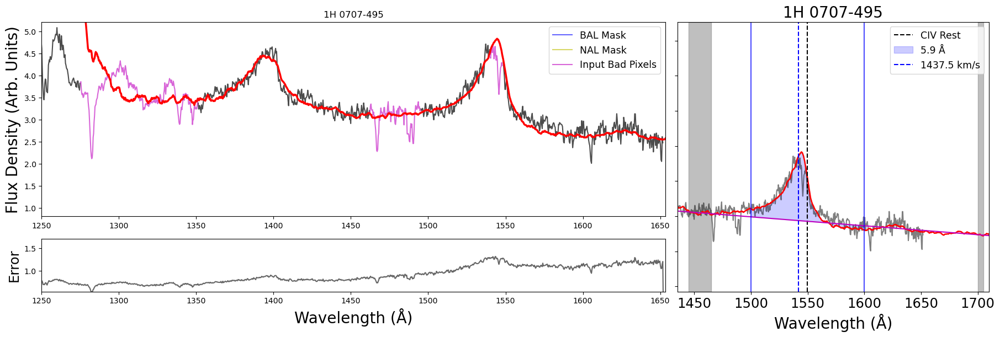

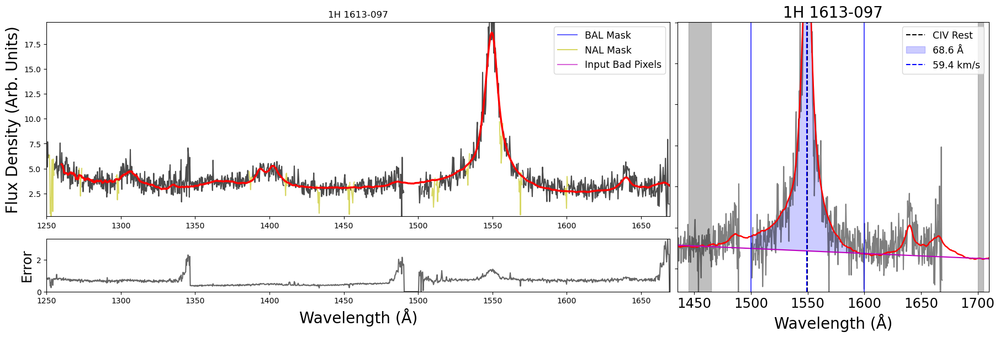

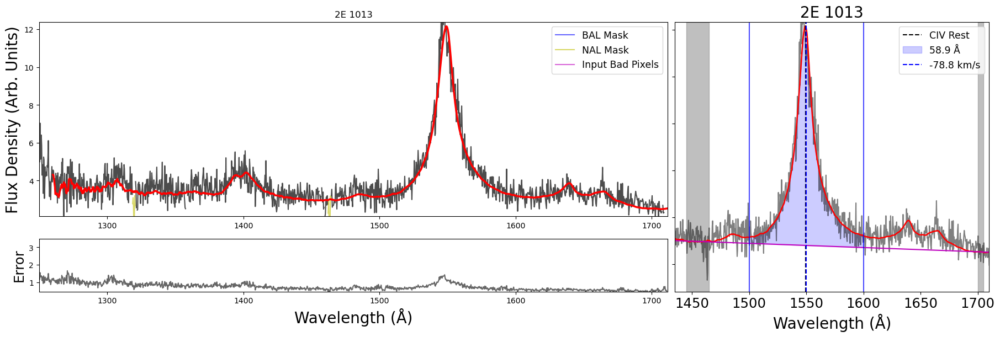

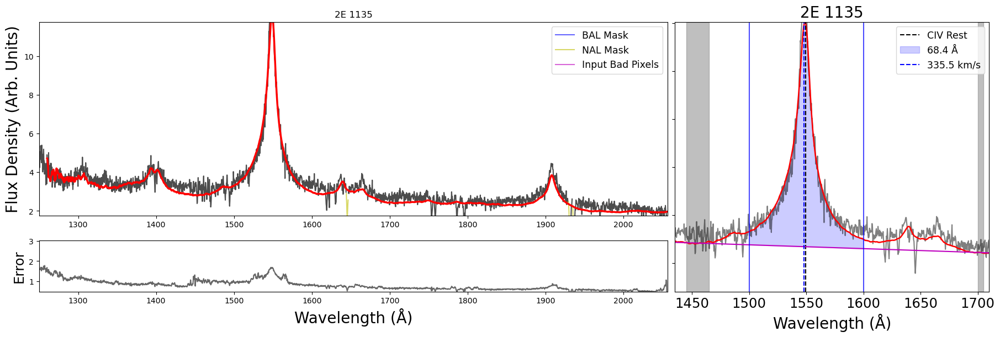

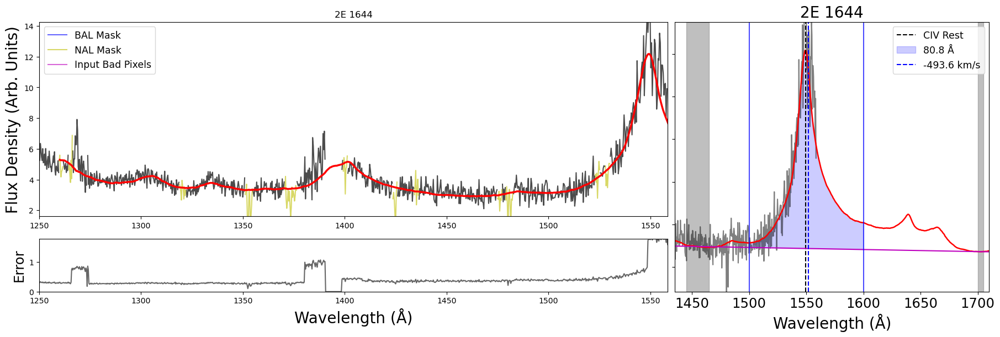

...

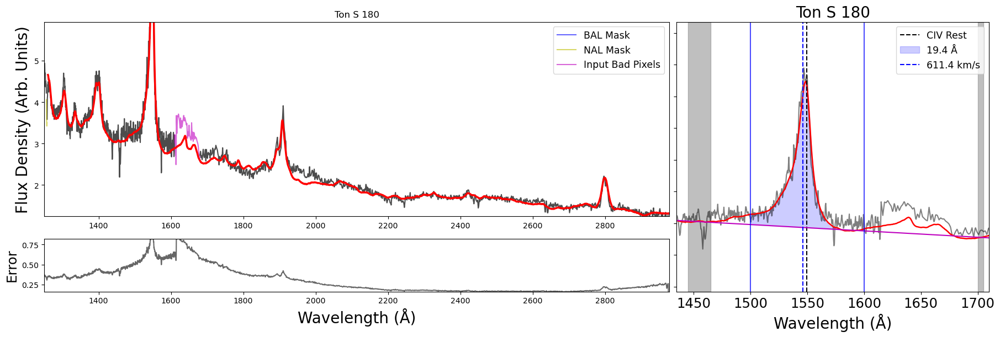

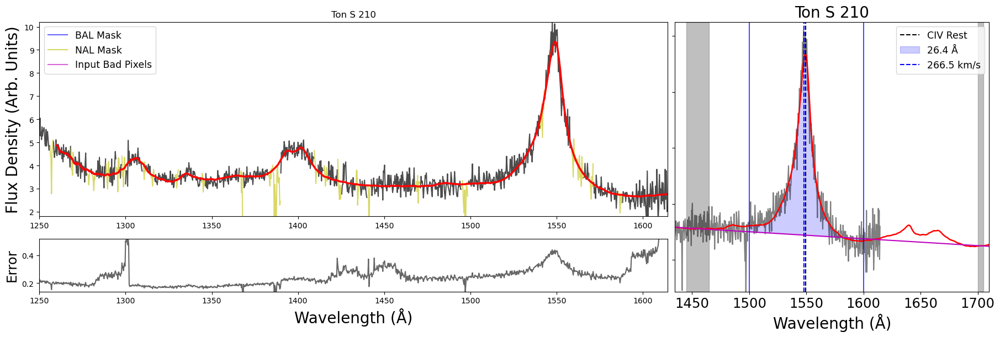

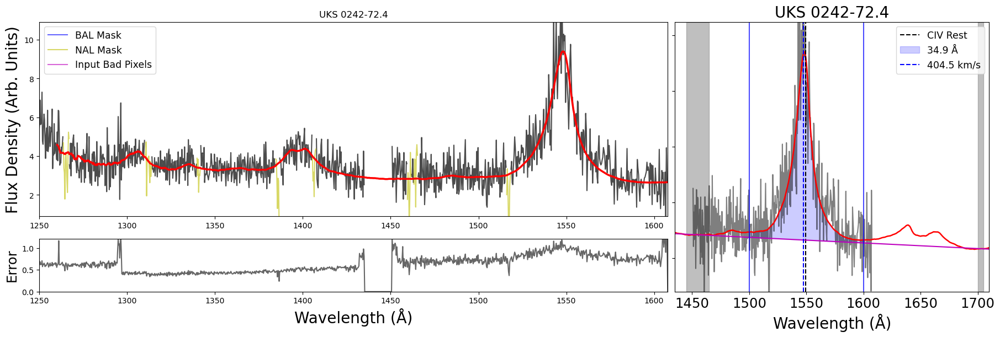

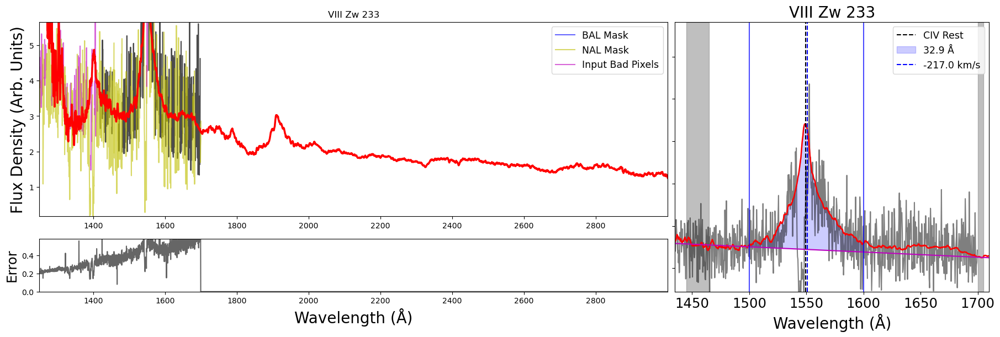

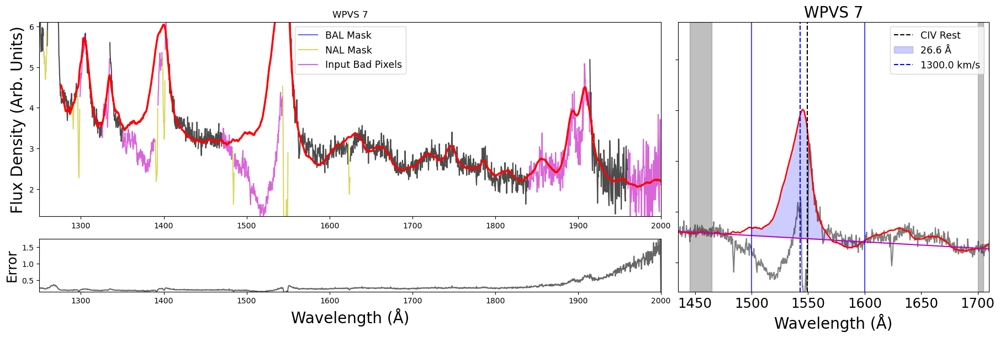

In [14]:
for name,name_save,name_title,inst,g in zip(names_spec,names_save,names,inst_final,good):
    #if i>=np.where(names=="SDSSJ145108.76+270926.9")[0][0]:
    # fn_list = glob.glob("/Users/trevormccaffrey/Dropbox/HST/final_MarchApril2023/ICA_reconstructions_final_March2023/spectra_morphed/%s*%s*.fits"%(name,inst))
    fn_list = glob.glob("spectra_morphed/%s*%s*.fits"%(name,inst))
    if len(fn_list)==0:
        print(name)
        continue
    else:
        fn = fn_list[0]
        #fn_ica_list = glob.glob("/Users/trevormccaffrey/Dropbox/HST/final_MarchApril2023/ICA_reconstructions_final_March2023/reconstructions_final/%s*.fits"%name)
        fn_ica_list = glob.glob("reconstructions_final/%s*.fits"%name)
        fn_ica = fn_ica_list[0]

    spec = fits.open(fn)
    z    = spec[1].data["Redshift"][0]
    wave = spec[1].data["Rest-Frame Wavelength"] 
    flux = spec[1].data["Coadded Flux (Arbitrary Units)"]
    errs = spec[1].data["Coadded Flux Errors"] 
    mask = spec[1].data["Bad Pixel Mask"]

    spec_ica = fits.open(fn_ica)
    wave_ica = spec_ica[1].data["ICA Wave"]
    flux_ica = spec_ica[1].data["ICA Reconstruction"]

    c4mask = wave>1400
    ylow, yhigh = max(0, np.nanpercentile(flux, 1)), np.nanpercentile(flux[c4mask], 99)+0.2*np.nanmedian(flux[c4mask])
    ylow_err, yhigh_err = max(0, np.nanpercentile(errs, 1)), np.nanpercentile(errs, 99)
    #xlow, xhigh = max(min(wave), 1360), min(max(wave), max(wave_ica))
    xlow, xhigh = max(min(wave), 1250), min(max(wave), max(wave_ica))

    fig = plt.figure(figsize=(18,6), constrained_layout=True)
    gs  = GridSpec(4, 12, figure=fig)
    ax1 = fig.add_subplot(gs[:3,:8]) #ica reconstruction
    ax2 = fig.add_subplot(gs[:,8:])   #CIV fitting
    ax3 = fig.add_subplot(gs[3,:8], sharex=ax1)
    plt.subplots_adjust(hspace=0)

    #ax1.plot(wave, flux, "-k", alpha=0.6)
    plot_HST(wave, flux, mask, ax1)
    ax1.plot(wave_ica, flux_ica, "-r", lw=2.5)

    ax3.plot(wave, errs, "-k", alpha=0.6)

    blue, ew = get_CIV(wave, flux, wave_ica, flux_ica, name_title, ax=ax2)

    ax1.set_xlim(xlow, xhigh)
    ax1.set_ylim(ylow, yhigh)
    ax1.set_title(name_title)
    ax3.set_xlim(xlow, xhigh)
    ax3.set_ylim(ylow_err, yhigh_err)
    ax1.set_ylabel("Flux Density (Arb. Units)", fontsize=20)
    ax3.set_xlabel("Wavelength (Å)", fontsize=20)
    ax3.set_ylabel("Error", fontsize=17.5)
    ax1.legend(loc="best", prop={"size":12.5})
    # if g==1:
    #     plt.savefig("/Users/trevormccaffrey/Dropbox/HST/final_MarchApril2023/plots/ICA_full/good/%s_%s_fullICA_wCIV.png"%(name_save,inst))
    # else:
    #     plt.savefig("/Users/trevormccaffrey/Dropbox/HST/final_MarchApril2023/plots/ICA_full/bad/%s_%s_fullICA_wCIV.png"%(name_save,inst))
    plt.show()
    #blue, EW = get_CIV(wave, flux, wave_reconst, reconstruction, name)
    #dat.at[names==name,dat.columns=="CIV_blue_tvm"] = blue
    #dat.at[names==name,dat.columns=="CIV_EW_tvm"]   = EW

    #break

In [15]:
get_CIV?

Signature:
get_CIV(
    wave,
    flux,
    wave_r,
    flux_r,
    name,
    ax=<Axes: >,
    EW_region=[1500, 1600],
    cont_region=[[1445, 1465], [1700, 1705]],
    good=1,
)
Docstring: <no docstring>
File:      c:\users\alexandros pratsos\appdata\local\temp\ipykernel_39384\3124195798.py
Type:      function

In [ ]:
(dat["ICA_Mask_Converge?"]==0).sum()

In [ ]:
dat.iloc[names=="IZW1",:]

In [ ]:
names